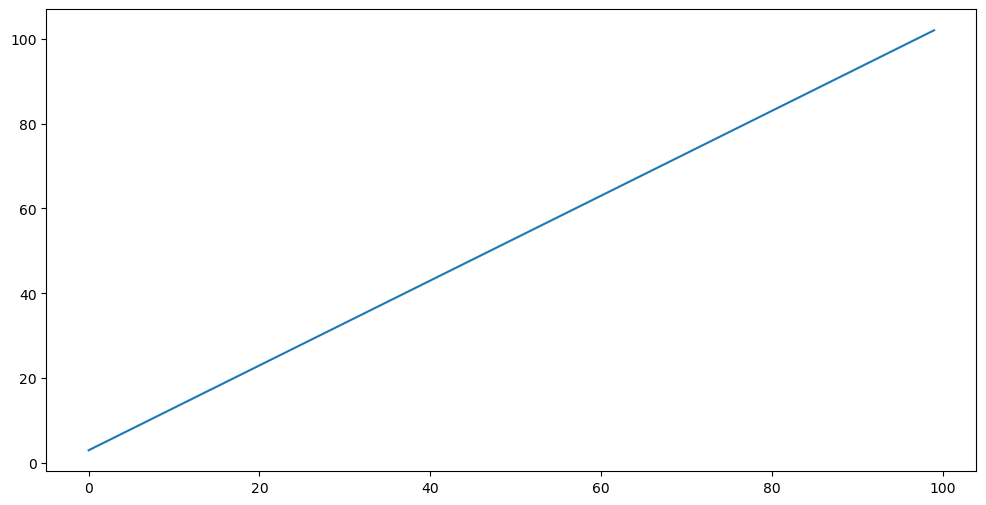

array([  3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,  14,  15,
        16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,  27,  28,
        29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,  40,  41,
        42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,  53,  54,
        55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,  66,  67,
        68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,  79,  80,
        81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,  92,  93,
        94,  95,  96,  97,  98,  99, 100, 101, 102])

In [1]:
##lineAndRandomPoints
import numpy as np
import matplotlib.pyplot as plt

line = np.array([i + 3 for i in range(100)])
figure = plt.figure(figsize = (12,6))
plt.plot(line)
plt.show()
line

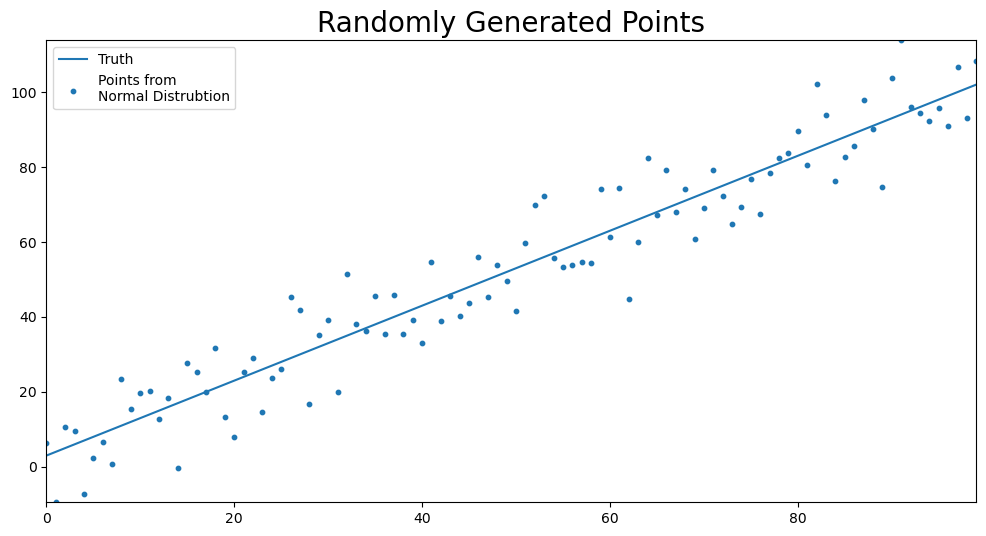

In [2]:
import random

points = []
for point in line:
    points.append(random.normalvariate(point, 10))

figure = plt.figure(figsize = (12, 6))
plt.rcParams["axes.xmargin"] = 0
plt.rcParams["axes.ymargin"] = 0
plt.plot(line, label ="Truth")
plt.scatter(np.arange(len(points)), points, s = 10,
           label = "Points from\nNormal Distrubtion")
plt.title("Randomly Generated Points", fontsize = 20)
plt.legend(loc = "best")
plt.show()

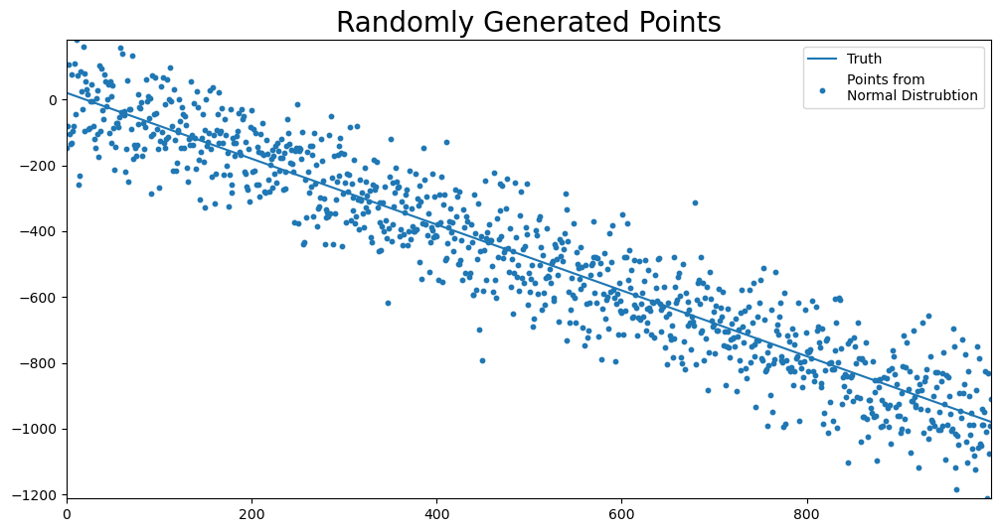

In [3]:
import random

def build_random_data_with_line(y_int, slope, SD = 1, line_length = 100):
    line = np.array([slope * i + y_int for i in range(line_length)])    
    points = []
    for point in line:
        points.append(random.normalvariate(point, SD))
        
    return line, points

def plot_line(line, points, line_name = "Truth",
              title = "Randomly Generated Points"):

    figure = plt.figure(figsize = (12, 6))
    plt.rcParams["axes.xmargin"] = 0
    plt.rcParams["axes.ymargin"] = 0
    plt.plot(line, label =line_name)
    plt.scatter(np.arange(len(points)), points, s = 10,
               label = "Points from\nNormal Distrubtion")
    plt.title("Randomly Generated Points", fontsize = 20)
    plt.legend(loc = "best")
    plt.show()
    
line, points = build_random_data_with_line(y_int = 20, slope = -1, SD = 100, line_length = 1000)
plot_line(line, points)

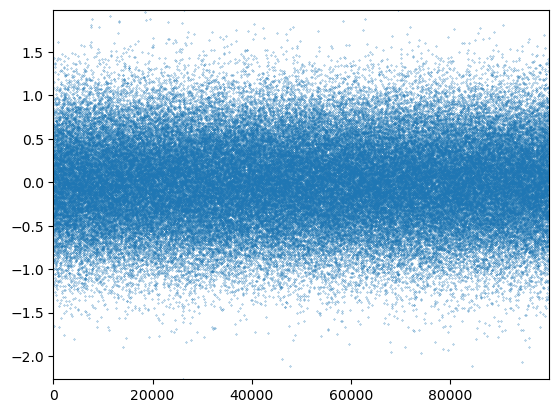

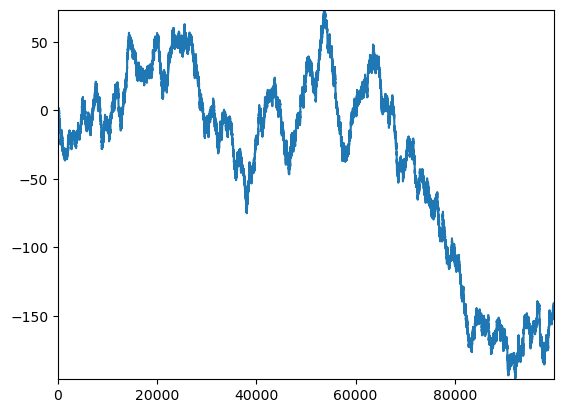

In [4]:
#montecarloSimulation

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import random


mu = 0
#SD is sigma, variance is sigma**2
sigma = .5
random_list = []
observations = 100000
for i in range(100000):
    random_list.append(random.normalvariate(mu, sigma))

plt.plot(random_list, ls = "",linewidth = 1, marker =".", markersize = .5)
plt.show()
plt.close()

simulation = [] 

for i in range(len(random_list)):
    val = random_list[i]
    if i == 0:
        simulation.append(val)
    else:
        simulation.append(simulation[i-1] + val)
        
plt.plot(simulation)
plt.show()
plt.close()



In [5]:
def run_monte_carlo(mean, sigma, num_sims, sim_dict, index):
    
    for i in range(num_sims):
        sim_dict[i] = {}
        for ix in index:
            sim_dict[i][ix] = random.normalvariate(mean, sigma)


In [6]:
mean = 0
sigma = 1
monte_carlo_sim_dict = {}
num_sims = 2000
index = np.arange(2000)
run_monte_carlo(mean, sigma, num_sims, monte_carlo_sim_dict, index)
        
monte_carlo_sim_df = (pd.DataFrame(monte_carlo_sim_dict))
        
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999
0,-0.617736,-1.594626,-0.656647,1.424586,0.286455,-0.432012,0.500177,-1.321660,-0.527143,0.479819,...,0.642067,-0.088978,-0.507964,-0.250820,-2.512729,-0.073069,-0.108158,1.348523,0.182140,-1.172760
1,1.709946,-0.585605,1.696426,-0.242880,2.062758,1.971275,-0.262311,1.856824,-0.345362,-0.174747,...,-0.589064,1.182472,1.588734,1.009296,-1.332110,0.140523,0.020270,-0.862924,-1.686383,0.765378
2,-0.369085,-1.009516,0.339234,-0.677439,0.452203,-0.389763,0.531597,-0.972024,1.419114,-1.147884,...,-0.784778,1.461324,0.347890,-0.396496,0.610105,0.461236,0.930751,0.549993,0.514907,-0.149023
3,-0.828048,0.963767,0.065707,0.068210,0.016465,0.938659,1.016333,-0.644289,0.114971,0.061500,...,-0.743499,-0.589204,0.475953,-0.799661,1.405616,0.291356,1.194474,-0.710401,1.540602,0.017629
4,0.987089,-0.254573,-0.921736,-1.155952,0.954791,-0.989828,-0.249652,-0.000012,1.990301,-1.074723,...,2.071565,-0.749853,-1.363529,1.413030,0.749608,0.656616,-1.071842,0.568294,-1.261605,-0.248589
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,-2.539120,-1.001648,-0.201264,0.937200,-0.034016,0.098974,-0.065924,0.664548,-1.338694,-1.640307,...,-1.132473,-0.474305,0.345925,0.514108,-0.011751,-0.406629,0.367967,1.344440,0.274206,0.260582
1996,0.345725,0.748099,-0.235325,-0.716488,-0.604718,0.619504,0.579921,2.185537,-2.594143,1.937991,...,-0.399929,-1.527777,0.006615,0.952902,1.938419,-0.806451,0.140602,-0.065631,0.937986,1.354240
1997,-0.541069,-0.548317,-0.782878,-0.351553,-1.947446,0.100398,-0.967531,-1.032588,0.023698,0.213999,...,-0.011564,-0.408837,-0.586919,-1.626332,-1.919948,-0.086292,1.734460,0.674947,0.234967,-0.412911
1998,-0.749806,1.181166,-0.196242,-0.590288,-0.307811,0.242665,0.785643,1.096801,0.922268,-0.054499,...,0.511291,-0.584142,1.106389,1.308887,0.358028,-0.011402,0.424485,0.526125,0.334439,-1.304467


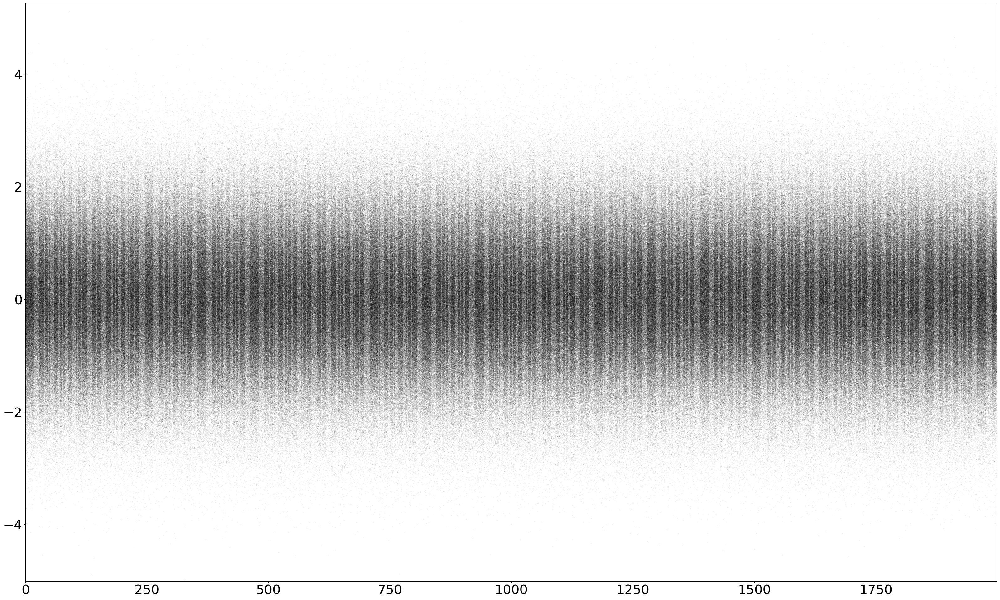

In [7]:
plt.rcParams["axes.xmargin"] = 0
plt.rcParams["axes.ymargin"] = 0
plt.rcParams["font.size"] = 30

fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.plot.line(legend = False, ls = " ", marker=".", markersize = .2, 
                            color ="k", alpha = .5, ax = ax)

plt.show()

C:\Users\JLCat\AppData\Local\Temp\ipykernel_6876\667913757.py:7: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([str(int(y * 100)) + "%" for y in y_vals])


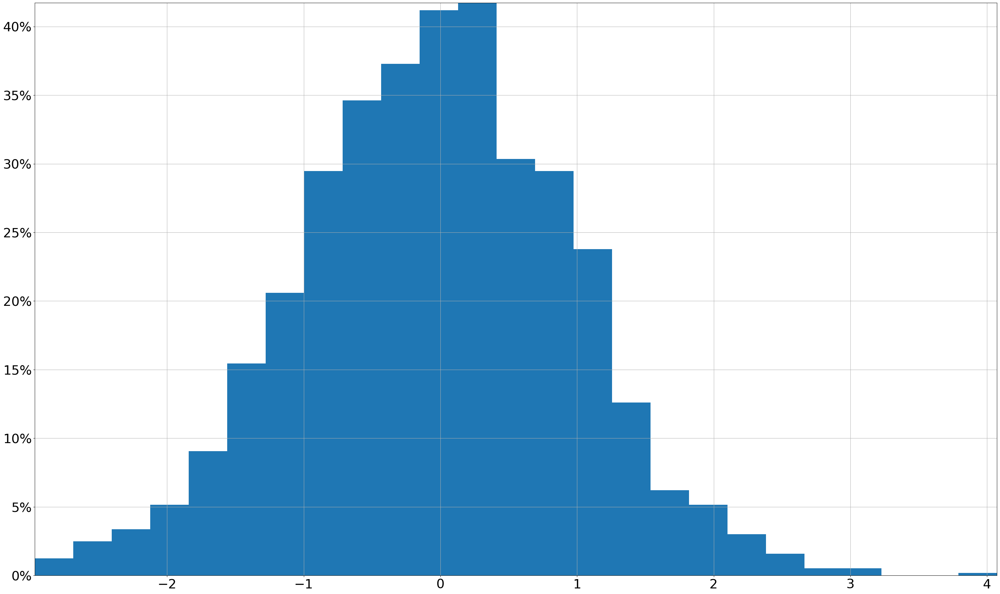

In [8]:
fig, ax = plt.subplots(figsize = (40, 24))
monte_carlo_sim_df.iloc[-1].hist(bins = 25, density = True,
                                ax = ax)

# set vertical axis values as percent
y_vals = ax.get_yticks()
ax.set_yticklabels([str(int(y * 100)) + "%" for y in y_vals])
plt.show()
plt.close()

## Monte Carlo with a Positive Trend

In [9]:
mean = .05
sigma = .5
monte_carlo_sim_dict = {}
num_sims = 2000
periods = 2000
index = np.arange(periods)
run_monte_carlo(mean, sigma, num_sims, monte_carlo_sim_dict, index)

monte_carlo_sim_df = pd.DataFrame(monte_carlo_sim_dict).cumsum()
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,1990,1991,1992,1993,1994,1995,1996,1997,1998,1999
0,-0.797277,0.118632,0.318344,0.062300,0.613972,0.468549,-0.592011,0.546430,-0.819405,0.872294,...,0.104672,-0.742927,-0.505213,0.033454,-0.043680,0.284341,0.268437,0.339503,0.662732,0.311624
1,-0.691469,-0.146145,1.140473,0.301272,-0.130027,0.853738,-0.150882,0.955703,-0.653197,1.198809,...,0.139250,-0.691375,-0.377697,0.169411,0.485865,-0.375538,1.175168,0.860899,0.403139,0.045364
2,-0.655501,0.137408,1.810221,0.777866,-0.884646,0.913825,-0.406840,0.750548,0.012097,1.546142,...,-0.229155,-1.077265,-0.432217,0.359051,1.276734,0.286184,1.833010,0.278035,-0.341241,-1.454083
3,-0.334338,0.308535,1.481718,1.340745,-0.521935,1.239823,0.714886,0.456233,0.637200,1.510543,...,-0.302823,-0.740039,-0.361614,0.206475,0.910179,0.550018,1.279580,-0.049059,-0.453724,-2.031392
4,-0.427131,0.339074,2.303492,1.407490,-0.473467,1.007777,1.219169,0.541024,0.765553,2.214329,...,-0.543203,-0.503336,-0.572589,0.035577,1.243082,-0.646300,1.673145,-0.481751,-0.231108,-1.894952
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,89.381931,55.355019,106.517960,56.304229,82.111957,95.471956,61.462455,96.786331,75.142175,96.260483,...,109.126533,40.082250,111.242689,87.356528,70.209018,107.773024,93.650758,77.403249,126.294001,59.200534
1996,89.347625,55.839603,106.608646,56.245079,81.895350,94.949737,61.397959,96.655257,74.957721,97.148150,...,109.706772,39.574621,110.785011,86.769402,70.265192,107.588840,93.861307,76.920444,125.664987,59.474516
1997,89.179472,55.928624,106.498839,55.312431,82.195627,94.679443,61.968554,96.233735,74.253549,97.358998,...,110.696511,39.774499,111.263057,86.810099,70.301564,106.950107,93.787723,77.035636,125.851634,58.752575
1998,88.690503,55.973464,106.957585,55.033328,82.862398,95.355724,62.776565,96.296562,74.201874,98.465055,...,110.934268,40.015533,110.796907,87.012411,70.465665,107.678284,94.095038,76.111077,125.491092,58.307750


In [10]:
def plot_monte_carlo_sim(sim_data,  title = None, logy = True):
    sim_data["mean"] = sim_data.mean(axis=1)
    fig, ax = plt.subplots(figsize = (40, 24))
    sim_data.drop("mean", inplace = False, axis = 1).plot.line(
            legend=False, ls = "", marker =".", markersize = .2, color = "k", 
        alpha = .05, logy = logy, ax = ax)
    sim_data["mean"].plot.line(legend = False, color = "C3", 
                               linewidth = 5, logy = logy, ax = ax)
    
    
    plt.title(title, fontsize = 50)
    plt.show()
    plt.close()

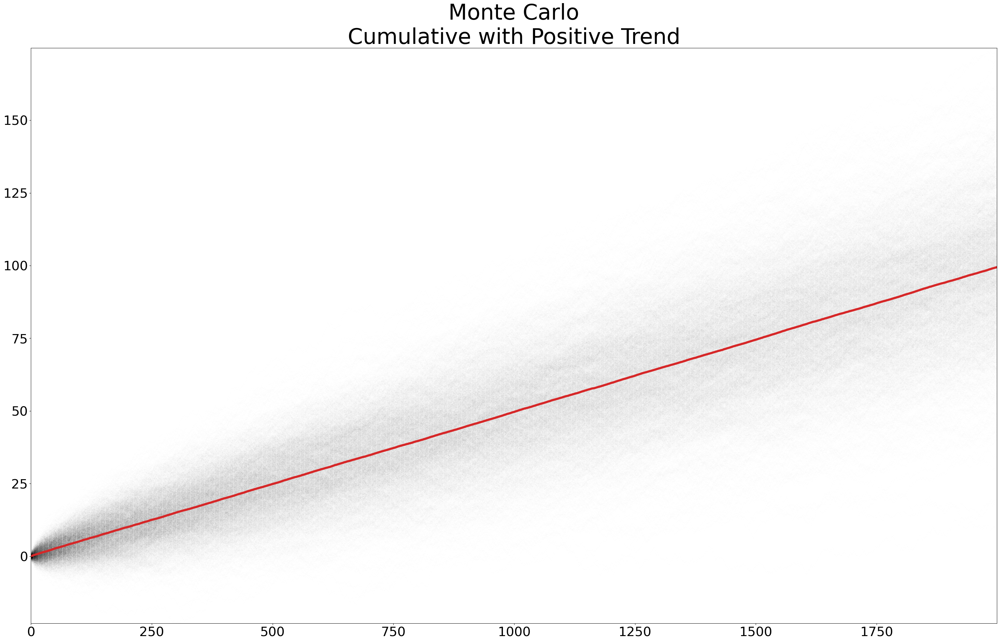

In [11]:
plot_monte_carlo_sim(monte_carlo_sim_df,  
    title = "Monte Carlo\nCumulative with Positive Trend", logy = False)


### Calculating Expected Value

In [12]:
monte_carlo_sim_df["mean"] = monte_carlo_sim_df.mean(axis = 1)
monte_carlo_sim_df["mean"]

0        0.033242
1        0.096020
2        0.162260
3        0.219889
4        0.285227
          ...    
1995    99.274129
1996    99.324553
1997    99.359106
1998    99.403979
1999    99.451631
Name: mean, Length: 2000, dtype: float64

### Simulating Changes in Portfolio Values

In [13]:
import pandas_datareader.data as web
import datetime
import yfinance  as yf
yf.pdr_override()

start = datetime.datetime(2005, 1, 1)
end = datetime.datetime.today()

data_dict = {}
stocks = "MSFT", "AAPL", "IBM", "GOOG"
for name in stocks:
    data_dict[name] =web.get_data_yahoo(name, start, end)

# make a list of the close data for each stock
close_data_dict = {key:val["Close"] for key, val in data_dict.items()}
close_data_df = pd.DataFrame(close_data_dict)

[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed
[*********************100%%**********************]  1 of 1 completed


In [14]:
close_data_pct_change = close_data_df.pct_change()
close_data_pct_change

,MSFT,AAPL,IBM,GOOG
Date,,,,
2005-01-03,NaN,NaN,NaN,NaN
2005-01-04,0.003740,0.010270,-0.010742,-0.040501
2005-01-05,-0.002235,0.008758,-0.002068,-0.005090
2005-01-06,-0.001120,0.000775,-0.003109,-0.025632
2005-01-07,-0.002991,0.072811,-0.004366,0.028109
...,...,...,...,...
2024-04-25,-0.024495,0.005147,-0.082510,-0.019553
2024-04-26,0.018244,-0.003473,-0.010538,0.099652
2024-04-29,-0.010017,0.024808,0.001795,-0.033335


In [15]:
close_data_normalized = close_data_pct_change.add(1).cumprod()
close_data_normalized.fillna(1, inplace =True)
close_data_normalized

,MSFT,AAPL,IBM,GOOG
Date,,,,
2005-01-03,1.000000,1.000000,1.000000,1.000000
2005-01-04,1.003740,1.010270,0.989258,0.959499
2005-01-05,1.001496,1.019118,0.987212,0.954615
2005-01-06,1.000374,1.019908,0.984143,0.930146
2005-01-07,0.997382,1.094169,0.979847,0.956292
...,...,...,...,...
2024-04-25,14.922962,150.321314,1.807467,31.284499
2024-04-26,15.195214,149.799276,1.788419,34.402056
2024-04-29,15.043007,153.515499,1.791629,33.255253


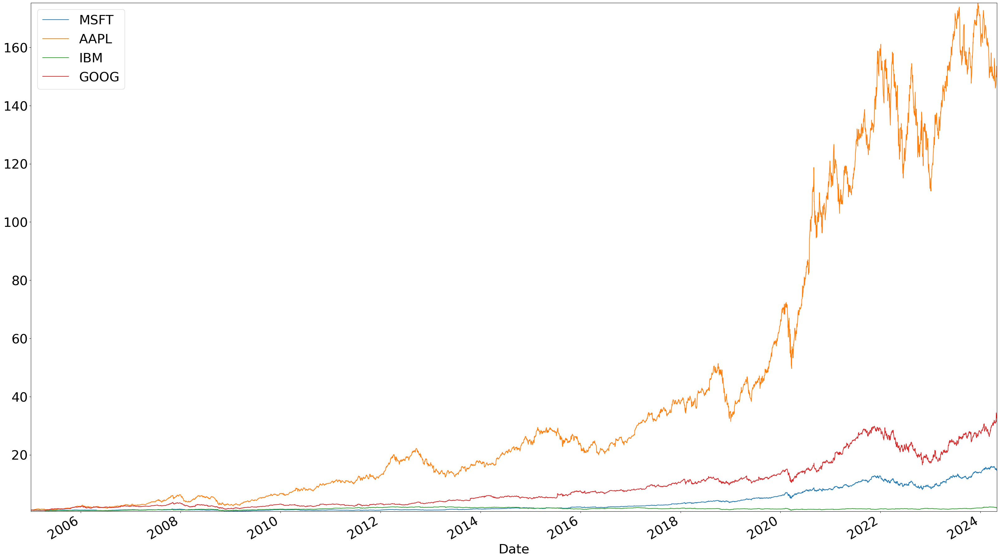

In [16]:
fig, ax = plt.subplots(figsize=(40,24))
close_data_normalized.plot.line(ax = ax)
plt.show()
plt.close()

### Daily Rate of Return

Derive the daily rate of return from the present value equation.

>$PV = \frac{FV}{(1 + r)^t}$
>
>Overall rate of return: $R=\frac{FV}{PV}$

Discount the overall rate of return to find the average rate of return. We will use this to define the mean of the standard normal distribution:

>$ r = (R)^{\frac{1}{t}} - 1$
>
>$t$ is measured in days

In [17]:
mean_var_df = pd.DataFrame(
    {"mean": close_data_normalized.iloc[-1].div(close_data_normalized.iloc[0]) ** (
        1 / close_data_normalized["MSFT"].count()) - 1, 
                            "sigma" : close_data_pct_change.std()})
mean_var_df

,mean,sigma
MSFT,0.000554,0.017240
AAPL,0.001030,0.020422
IBM,0.000116,0.014477
GOOG,0.000718,0.019001


In [18]:
num_sims = 500
dates = list(close_data_df.index)
monte_carlo_sim_dict = {}
for stock in stocks:
    monte_carlo_sim_dict[stock] = {}
    mean = mean_var_df["mean"][stock]
    sigma = mean_var_df["sigma"][stock]   
    run_monte_carlo(mean, 
                    sigma, 
                    num_sims, 
                    monte_carlo_sim_dict[stock], 
                    dates)
#    monte_carlo_sim_dict[stock] = pd.DataFrame(monte_carlo_sim_dict[stock]).add(1).cumprod()
monte_carlo_sim_dfs = {stock: pd.DataFrame(monte_carlo_sim_dict[stock]).add(1).cumprod() for stock in stocks}

In [19]:
monte_carlo_sim_dfs

{'MSFT':                   0         1         2         3         4         5    \
 2005-01-03   1.020155  1.019778  0.975862  0.984798  0.995862  1.003018   
 2005-01-04   1.044164  1.032811  0.988353  0.999039  1.030586  0.999150   
 2005-01-05   1.070990  1.036004  0.993442  0.999835  1.034459  1.022057   
 2005-01-06   1.083988  1.016961  1.012522  1.022162  1.047634  0.997403   
 2005-01-07   1.109919  1.013980  1.037243  0.999925  1.029359  0.991460   
 ...               ...       ...       ...       ...       ...       ...   
 2024-04-25  58.660821  9.744284  3.249680  5.544705  4.732611  7.197360   
 2024-04-26  59.189236  9.654147  3.171895  5.520362  4.811305  7.213483   
 2024-04-29  59.194991  9.788287  3.181861  5.472955  4.754100  7.396699   
 2024-04-30  57.599666  9.937850  3.249068  5.513609  4.641944  7.548488   
 2024-05-01  58.792361  9.753722  3.208747  5.449909  4.563525  7.776820   
 
                  6         7          8          9    ...       490  \
 2005-

In [20]:
def plot_monte_carlo_sim(sim_data, 
                         observed_data = None, 
                         title = None, 
                         logy = True):
    sim_data["mean"] = sim_data.mean(axis=1)    
    index = sim_data.index
    fig, ax = plt.subplots(figsize = (40, 24))
    sim_data.drop(["mean"], inplace = False, axis = 1).plot.line(
            legend=False, marker =".",
        markersize = .1, 
        color = "k", 
        alpha = .05, 
        logy = logy, 
        ax = ax)
    if observed_data is not None:
        observed_data.plot.line(legend = False, 
                                color = "C2", 
                                linewidth = 5, 
                                logy = logy, 
                                ax = ax)
    
        # find x coordinate of lowest value observed
        obs_text_x = observed_data[observed_data == observed_data.min()].index
        plt.text(obs_text_x, observed_data.loc[obs_text_x] * .7,
                 "Observed", fontsize = 70, color = "C2")
    sim_data["mean"].plot.line(legend = False, color = "C3", 
                               linewidth = 5, logy = logy, ax = ax)
    plt.text(index[-400], sim_data["mean"].iloc[-400] * 1.5, "Exp\nVal",
            fontsize = 70, color = "C3")
   
    
    
    plt.title(title, fontsize = 50)
    plt.show()
    plt.close()

In [21]:
monte_carlo_sim_dfs[stock].median(axis = 1)

2005-01-03     1.001938
2005-01-04     1.003226
2005-01-05     1.005391
2005-01-06     1.006010
2005-01-07     1.006866
                ...    
2024-04-25    14.015606
2024-04-26    14.013042
2024-04-29    13.859988
2024-04-30    13.830745
2024-05-01    13.726069
Length: 4865, dtype: float64

C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

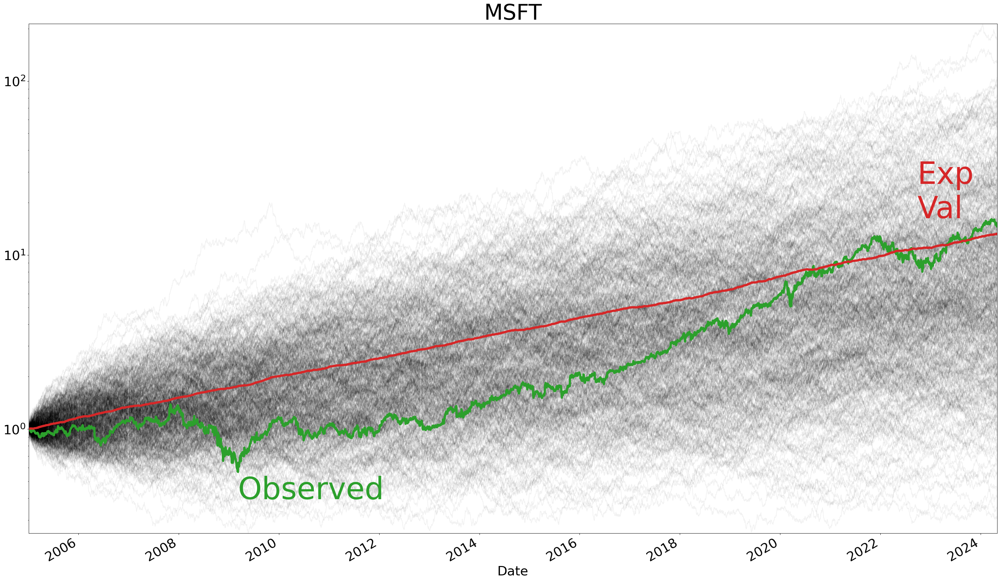

C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

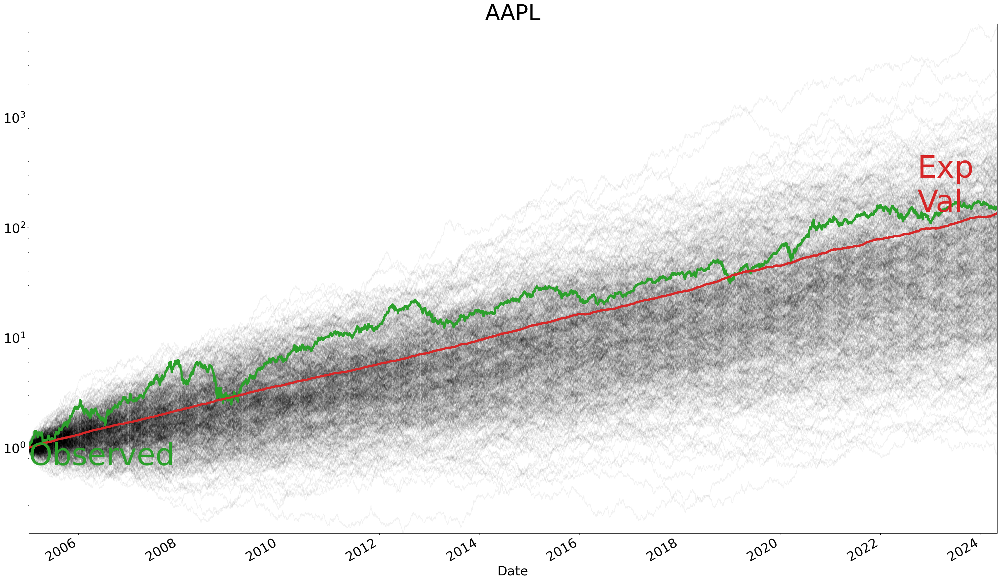

C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

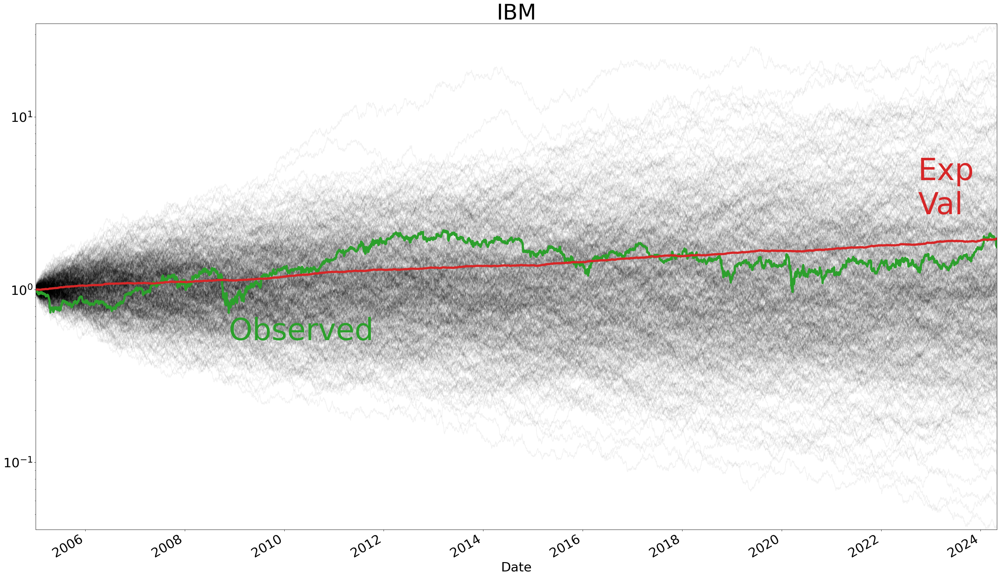

C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

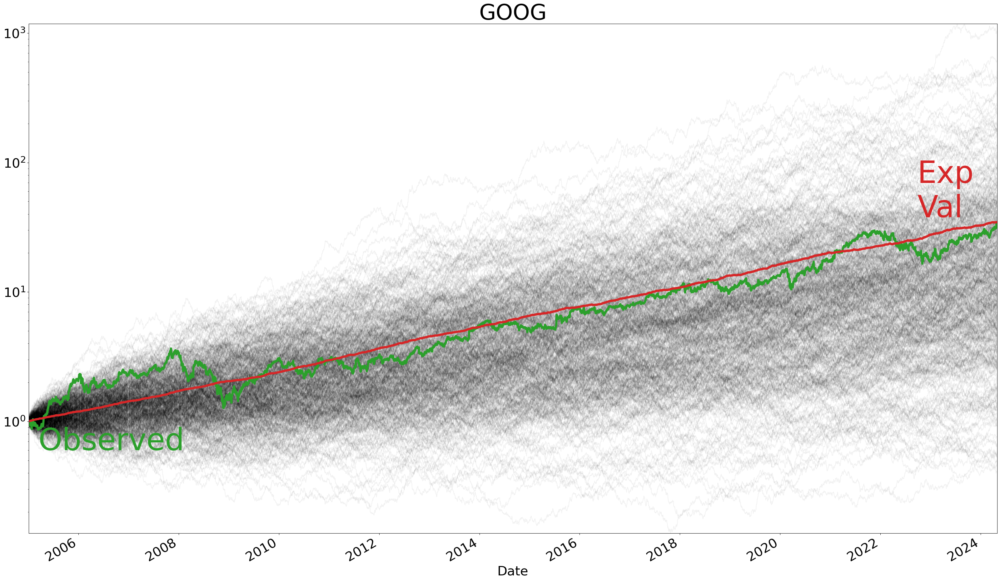

In [22]:
for stock in stocks:
    plot_monte_carlo_sim(monte_carlo_sim_dfs[stock], 
                         close_data_normalized[stock], 
                         stock, 
                         logy= True)


## Calculate Portfolio Return

In [23]:
portfolio_weights = {stock: 1 / len(stocks) for stock in stocks}
portfolio_weights

{'MSFT': 0.25, 'AAPL': 0.25, 'IBM': 0.25, 'GOOG': 0.25}

In [24]:
ex_return = pd.DataFrame(close_data_normalized.apply(lambda x :x.mul(portfolio_weights[x.name]),
                                                     axis = 0).sum(axis=1),
                                                    columns = ["Portfolio Return"])
close_data_normalized["Portfolio Return"] = ex_return
close_data_normalized

,MSFT,AAPL,IBM,GOOG,Portfolio Return
Date,,,,,
2005-01-03,1.000000,1.000000,1.000000,1.000000,1.000000
2005-01-04,1.003740,1.010270,0.989258,0.959499,0.990692
2005-01-05,1.001496,1.019118,0.987212,0.954615,0.990610
2005-01-06,1.000374,1.019908,0.984143,0.930146,0.983643
2005-01-07,0.997382,1.094169,0.979847,0.956292,1.006923
...,...,...,...,...,...
2024-04-25,14.922962,150.321314,1.807467,31.284499,49.584060
2024-04-26,15.195214,149.799276,1.788419,34.402056,50.296241
2024-04-29,15.043007,153.515499,1.791629,33.255253,50.901347


<Axes: xlabel='Date'>

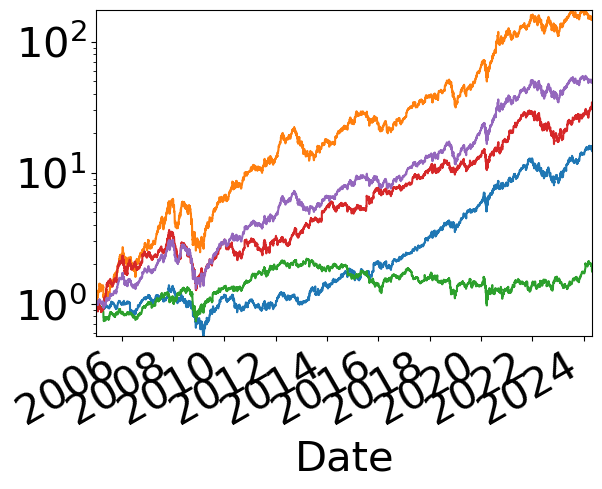

In [25]:
close_data_normalized.plot.line(legend=False, logy = True)

In [26]:
ex_return_pct_change = ex_return.pct_change()
ex_return_pct_change.dropna(inplace = True)
ex_return_pct_change

,Portfolio Return
Date,
2005-01-04,-0.009308
2005-01-05,-0.000082
2005-01-06,-0.007033
2005-01-07,0.023667
2005-01-10,0.001298
...,...
2024-04-25,-0.001969
2024-04-26,0.014363
2024-04-29,0.012031


In [27]:
mean_var_df = pd.DataFrame({"mean": (
    ex_return.iloc[-1] / ex_return.iloc[0]) **(
        1 / ex_return["Portfolio Return"].count()) -1,
                           "sigma" : ex_return_pct_change.std()})
mean_var_df

,mean,sigma
Portfolio Return,0.000804,0.016551


In [28]:
num_sims = 1000
dates = ex_return.index
monte_carlo_sim_dict = {}
mean = mean_var_df["mean"]["Portfolio Return"]
sigma = mean_var_df["sigma"]["Portfolio Return"]
run_monte_carlo(mean, 
                sigma, 
                num_sims, 
                monte_carlo_sim_dict, 
                dates)
monte_carlo_sim_df = pd.DataFrame(monte_carlo_sim_dict).add(1).cumprod()
monte_carlo_sim_df

,0,1,2,3,4,5,6,7,8,9,...,990,991,992,993,994,995,996,997,998,999
2005-01-03,1.021099,1.003223,0.997863,1.000616,1.012502,1.007541,1.010688,1.024734,0.997009,1.032259,...,0.992703,0.997691,1.006960,0.979967,1.021837,1.023509,1.009825,1.014494,1.005680,1.003920
2005-01-04,1.029612,1.029964,0.985687,1.015672,1.017788,0.994486,1.001097,1.021426,0.984489,1.053215,...,0.991081,1.007194,0.976741,0.949347,1.013017,1.044638,1.026962,1.034606,0.964364,0.998008
2005-01-05,1.049646,1.015059,1.006152,1.011947,1.022780,0.967978,1.005751,1.022198,1.006541,1.087630,...,1.017161,1.017307,0.978193,0.929800,1.012618,1.055785,1.067334,1.039524,0.980668,1.019713
2005-01-06,1.066314,1.026362,0.999489,1.025160,0.984518,0.954543,0.993394,1.041542,1.013625,1.066188,...,0.998843,1.027513,0.975116,0.947857,1.002497,1.068691,1.099445,1.069374,0.957478,0.989227
2005-01-07,1.101713,1.014038,0.980768,1.018339,0.996342,0.957970,0.981281,1.030826,0.987893,1.054977,...,0.980512,1.029185,0.978026,0.939242,1.035832,1.090986,1.103276,1.069751,0.962048,0.968613
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-04-25,33.371114,20.135528,10.293757,0.398958,58.392502,78.634887,30.434434,135.590916,14.467433,95.817726,...,58.122586,5.718003,17.320202,27.727581,16.987162,4.990211,1.457247,42.666247,6.608825,32.251655
2024-04-26,33.831348,19.764743,10.249122,0.402313,58.589012,77.615562,30.117361,134.078177,14.257631,95.554493,...,58.188667,5.718931,17.283924,26.817119,16.781301,4.885605,1.508787,42.741826,6.708594,32.773641
2024-04-29,34.259687,20.099232,10.105930,0.409395,60.287334,76.174695,29.583280,132.935825,14.073130,95.710023,...,58.684589,5.733608,17.361489,27.012841,16.653022,5.037114,1.489630,42.277975,6.682451,32.915715
2024-04-30,34.578874,19.990838,10.276099,0.408988,61.700347,77.119753,29.583263,134.606652,14.049845,94.293720,...,59.207599,5.648460,17.578953,27.465682,16.397884,5.040872,1.479466,42.119843,6.750075,33.500398


C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:754: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  posy = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits(self._y))
C:\ProgramData\anaconda3\Lib\site-packages\matplotlib\text.py:895: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  y = float(self.convert_yunits

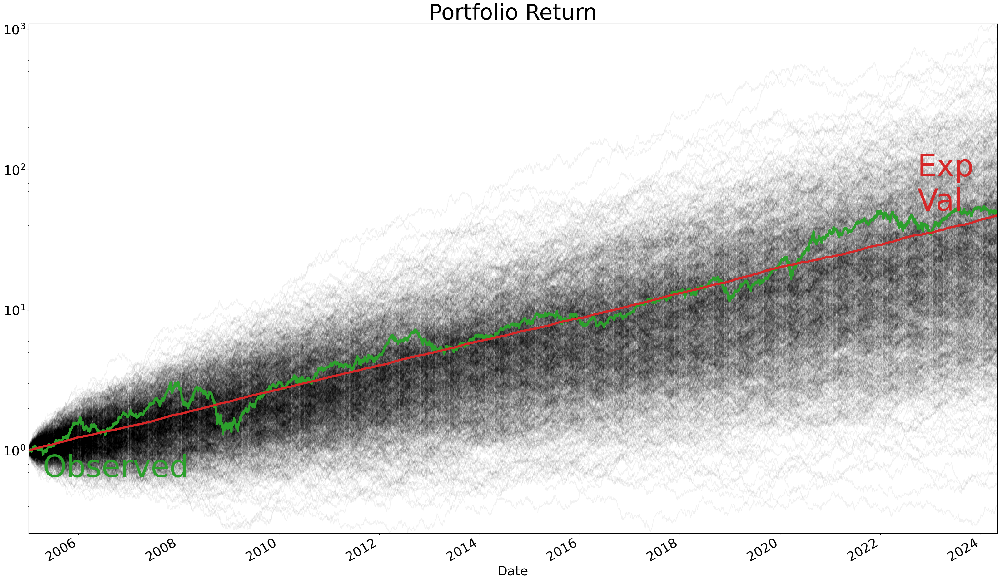

In [29]:
plot_monte_carlo_sim(monte_carlo_sim_df, 
                     ex_return["Portfolio Return"], 
                     "Portfolio Return", 
                     logy= True)